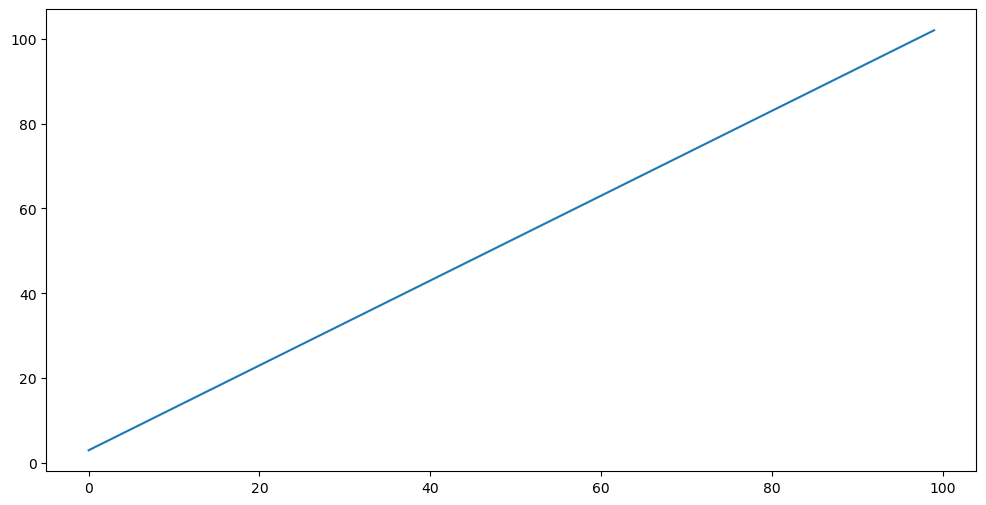

array([  3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,
        16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
        29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
        68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  98,  99, 100, 101, 102])

In [1]:
##lineAndRandomPoints
import numpy as np
import matplotlib.pyplot as plt

line = np.array([i + 3 for i in range(100)])
figure = plt.figure(figsize = (12,6))
plt.plot(line)
plt.show()
line

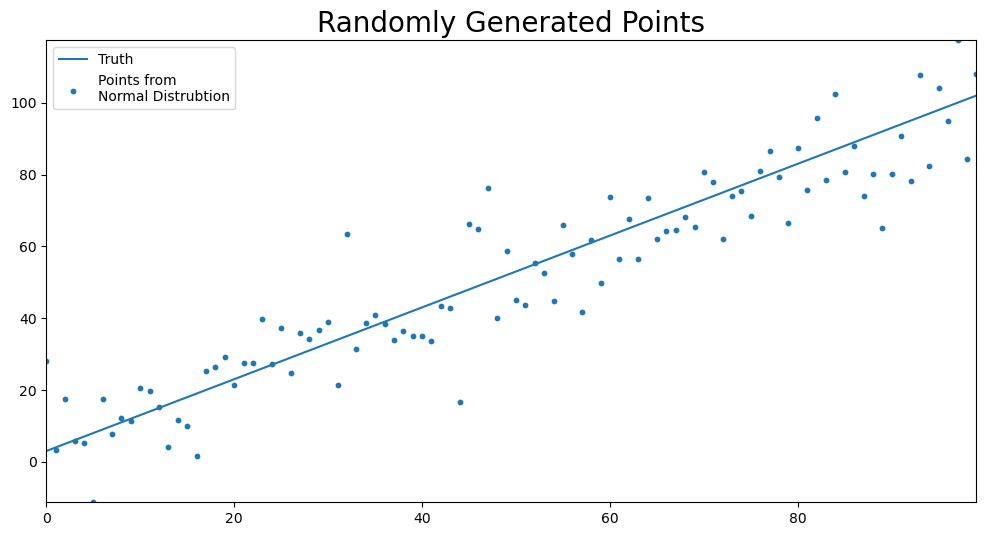

In [2]:
import random

points = []
for point in line:
    points.append(random.normalvariate(point, 10))

figure = plt.figure(figsize = (12, 6))
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.plot(line, label ="Truth")
plt.scatter(np.arange(len(points)), points, s = 10,
           label = "Points from\nNormal Distrubtion")
plt.title("Randomly Generated Points", fontsize = 20)
plt.legend(loc = "best")
plt.show()

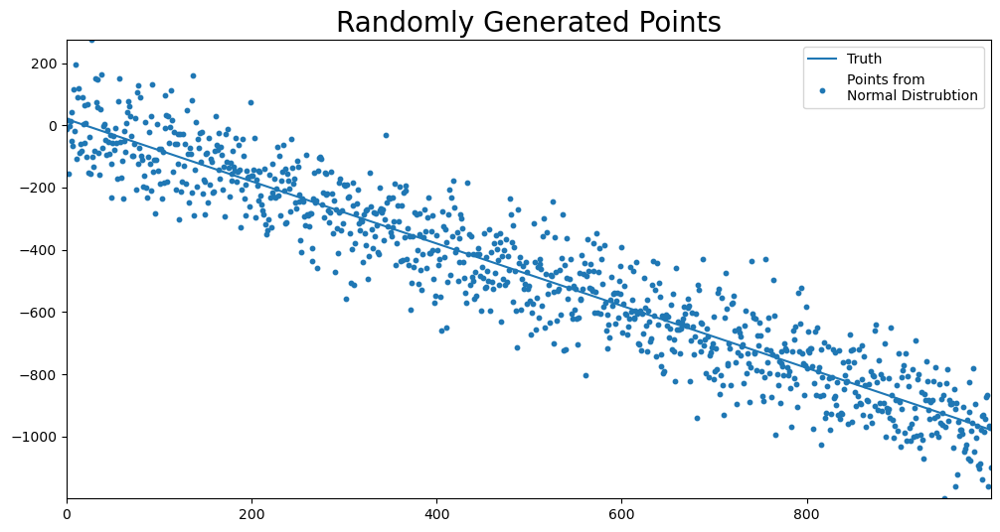

In [3]:
import random

def build_random_data_with_line(y_int, slope, SD = 1, line_length = 100):
    line = np.array([slope * i + y_int for i in range(line_length)])    
    points = []
    for point in line:
        points.append(random.normalvariate(point, SD))
        
    return line, points

def plot_line(line, points, line_name = "Truth",
              title = "Randomly Generated Points"):

    figure = plt.figure(figsize = (12, 6))
    plt.rcParams["axes.xmargin"] = 0
    plt.rcParams["axes.ymargin"] = 0
    plt.plot(line, label =line_name)
    plt.scatter(np.arange(len(points)), points, s = 10,
               label = "Points from\nNormal Distrubtion")
    plt.title("Randomly Generated Points", fontsize = 20)
    plt.legend(loc = "best")
    plt.show()
    
line, points = build_random_data_with_line(y_int = 20, slope = -1, SD = 100, line_length = 1000)
plot_line(line, points)

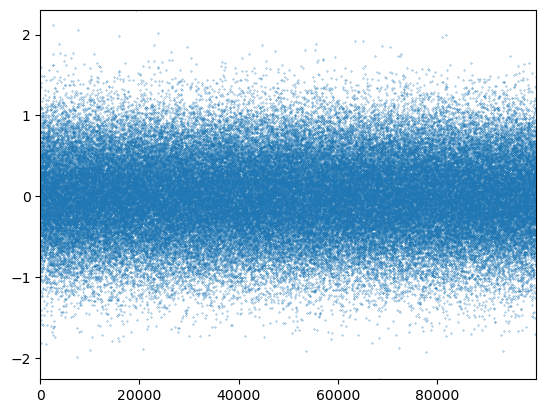

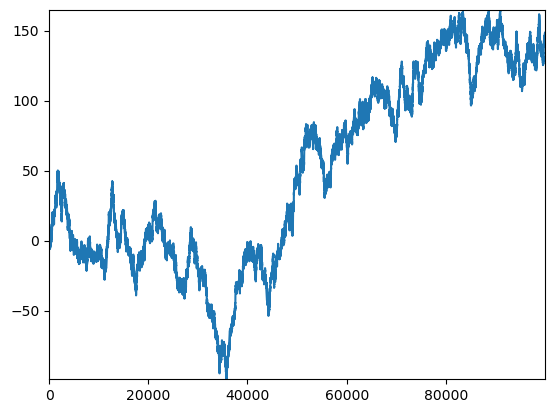

In [4]:
#montecarloSimulation

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random


mu = 0
#SD is sigma, variance is sigma**2
sigma = .5
random_list = []
observations = 100000
for i in range(100000):
    random_list.append(random.normalvariate(mu, sigma))

plt.plot(random_list, ls = "",linewidth = 1, marker =".", markersize = .5)
plt.show()
plt.close()

simulation = [] 

for i in range(len(random_list)):
    val = random_list[i]
    if i == 0:
        simulation.append(val)
    else:
        simulation.append(simulation[i-1] + val)
        
plt.plot(simulation)
plt.show()
plt.close()



In [5]:
def run_monte_carlo(mean, sigma, num_sims, sim_dict, index):
    
    for i in range(num_sims):
        sim_dict[i] = {}
        for ix in index:
            sim_dict[i][ix] = random.normalvariate(mean, sigma)


In [6]:
mean = 0
sigma = 1
monte_carlo_sim_dict = {}
num_sims = 2000
index = np.arange(2000)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)
        
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))
        
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,0.555194,0.995054,-1.386817,-0.253503,-0.992177,0.602084,0.447689,1.234321,-1.216652,2.456447,...,1.539192,0.262691,-0.307479,-0.152226,0.679223,-0.848633,0.373317,1.027055,1.006696,-0.554514
1,1.479908,-2.489754,0.522236,0.847944,1.212912,0.447199,0.069151,-1.126632,1.538872,-1.418466,...,-0.167432,1.988913,-1.618987,-1.085469,-1.246442,-0.548055,-1.766877,-0.677437,1.069895,1.234613
2,0.086316,-0.823375,0.650120,-0.436840,0.161955,0.611063,0.067847,1.258698,-0.036287,0.794773,...,-0.263412,-0.333420,-0.096757,-0.276110,-1.949130,2.237385,-2.238635,-0.054381,-0.952402,0.052209
3,0.626115,-0.489051,-1.873746,-1.378685,-1.591329,1.741042,1.429518,-2.077333,0.854827,-0.723880,...,-0.054779,-0.488396,-0.197235,-1.463163,0.231666,3.057377,0.159793,1.131873,0.683704,0.117866
4,-1.218235,-1.061681,-1.878437,0.445512,0.332360,0.226685,0.087388,-0.735729,-0.012967,0.338774,...,-0.407070,-1.167015,-0.224328,1.731024,1.915490,-0.200053,2.885408,-1.795489,-0.201222,0.055346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0.707097,-1.640410,1.637235,-0.206187,-0.315358,-0.633520,0.830611,0.909795,-2.348764,-0.056224,...,1.645420,0.536903,0.178043,-0.000723,0.454863,2.077057,0.915096,0.610310,0.417472,-0.237792
1996,0.281245,-0.411491,1.647706,1.408346,1.128888,1.236051,1.436606,0.748049,-1.457871,-0.025433,...,-2.620947,0.621444,0.916491,-1.001618,0.544732,0.234448,1.632776,0.259399,-0.932001,-1.680386
1997,0.137618,-0.445488,-1.311611,0.351121,0.140088,1.315192,-1.206134,0.828214,-0.041301,-1.451172,...,0.434841,-0.494959,-1.218452,-0.948882,0.443923,-1.142854,-0.807904,-0.091616,0.819709,-1.025477
1998,0.565780,-0.525247,0.906866,-0.400177,-0.467164,-1.219454,-0.701616,0.120447,0.360041,-1.396155,...,-0.799552,-0.253780,-1.574901,-0.311691,1.133459,0.042996,1.238739,0.347303,-2.551608,0.066552


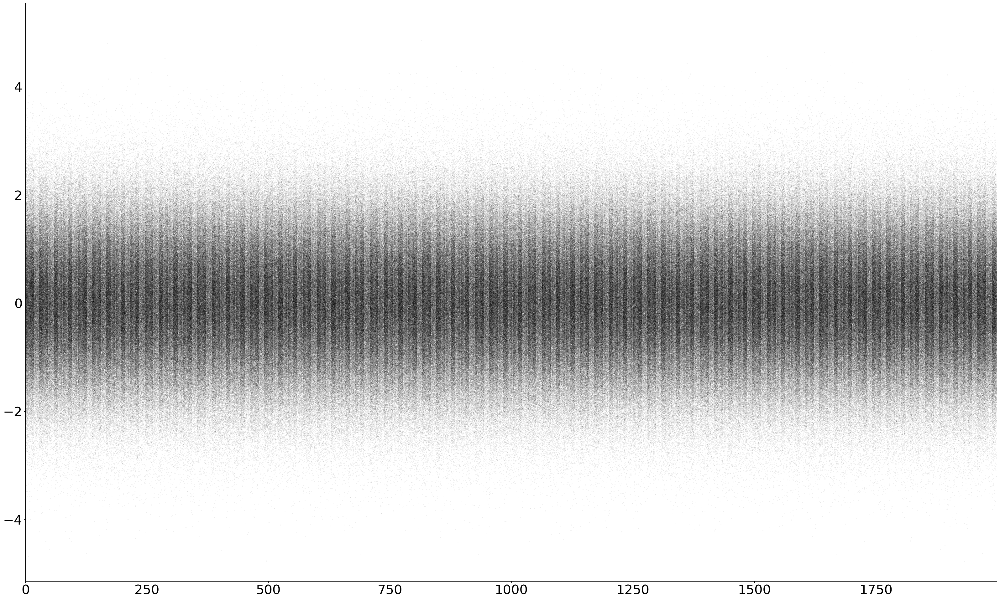

In [7]:
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.rcParams["font.size"] = 30

fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, ls = " ", marker=".", markersize = .2, 
                            color ="k", alpha = .5, ax = ax)

plt.show()

C:\Users\JLCat\AppData\Local\Temp\ipykernel_17308\667913757.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])


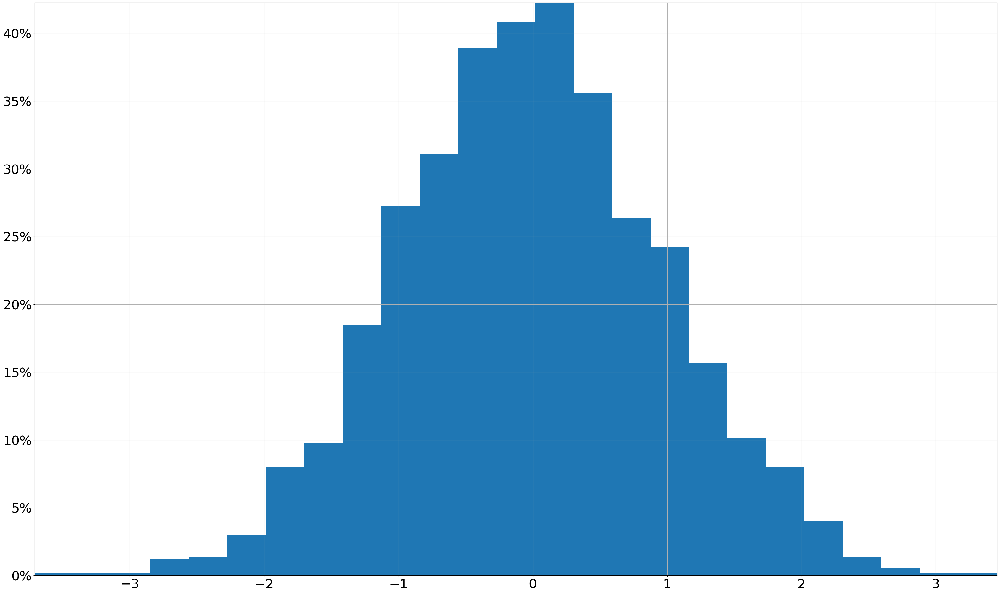

In [8]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.iloc[-1].hist(bins = 25, density = True,
                                ax = ax)

# set vertical axis values as percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])
plt.show()
plt.close()

## Monte Carlo with a Positive Trend

In [9]:
mean = .05
sigma = .5
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 2000
index = np.arange(periods)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)

monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).cumsum()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,0.503598,-0.238135,0.083779,0.217813,-0.112717,-0.160549,0.414129,-0.752192,-0.118454,-0.117686,...,0.072823,0.205010,-0.007935,-0.140016,0.284731,-0.502454,-0.343389,0.203959,0.109493,0.259394
1,1.145588,0.099502,0.470118,0.695402,0.335577,0.089328,0.242277,-0.197445,0.116305,-0.383678,...,-0.113541,-0.638385,0.411969,-0.225673,0.290471,-0.906950,-0.597794,0.243712,0.080233,-0.180046
2,1.423482,-0.783054,0.107927,1.361874,-0.294085,0.264662,0.396979,0.049898,0.191140,-0.907708,...,-1.507579,-0.320178,-0.099321,0.192349,1.217261,-0.165685,-0.555934,-0.439005,0.344943,-0.408820
3,1.203110,-0.982911,1.051550,1.854881,-0.711179,0.656780,-0.464074,-0.303688,-0.040584,-1.200486,...,-1.510084,-0.736332,0.587746,0.028887,2.135775,-0.813336,-0.373562,-0.237416,0.128956,0.041457
4,0.391843,-0.838234,1.307014,2.222179,-0.266070,1.210287,-0.552957,-0.403404,-0.551540,-0.980318,...,-2.504438,-1.175806,1.542578,0.150496,2.288159,-0.918361,-0.317508,-0.124400,0.311020,0.696706
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,105.815755,123.628408,79.822073,121.901640,106.683754,41.916236,88.251769,131.357156,51.762217,94.809614,...,106.061797,104.533197,65.918608,95.124196,122.288850,83.647003,116.045536,89.075010,59.881434,101.395517
1996,106.205649,123.698334,80.259722,122.707216,106.819773,41.742418,88.182905,130.743046,51.397794,95.666268,...,106.147163,105.131990,65.143307,94.535828,122.000360,83.744929,115.456250,88.537764,60.780180,101.823443
1997,106.567589,123.773205,79.670590,123.024066,105.402189,42.220126,87.582731,129.856262,51.017394,95.600807,...,106.634247,104.951045,64.127378,95.163285,121.969763,84.260689,115.287626,88.278394,61.525507,102.038913
1998,106.488344,124.843117,79.375141,122.756844,105.299425,41.546217,87.363946,129.325136,51.665795,95.712924,...,106.628325,104.875096,63.895078,94.651455,122.572988,84.262439,115.570692,88.718154,61.708352,101.589749


In [10]:
def plot_monte_carlo_sim(sim_data,  title = None, logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop("mean", inplace = False, axis = 1).plot.line(
            legend=False, ls = "", marker =".", markersize = .2, color = "k", 
        alpha = .05, logy = logy, ax = ax)
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

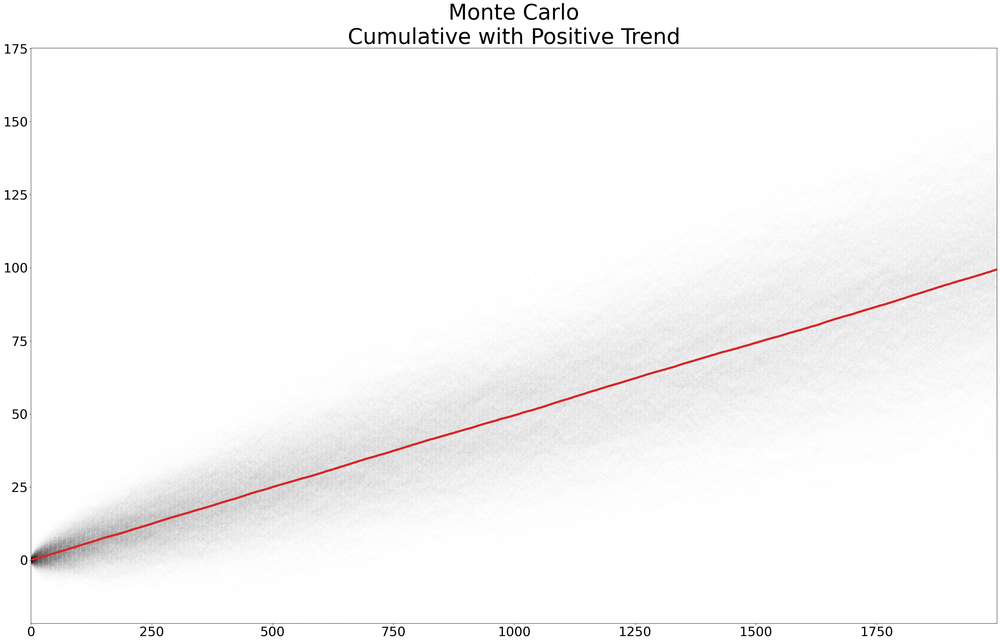

In [11]:
plot_monte_carlo_sim(monte_carlo_sim_df,  
    title = "Monte Carlo\nCumulative with Positive Trend", logy = False)


### Calculating Expected Value

In [12]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis = 1)
monte_carlo_sim_df["mean"]

0        0.056735
1        0.102927
2        0.166598
3        0.186098
4        0.253094
          ...    
1995    99.220638
1996    99.279310
1997    99.332207
1998    99.363172
1999    99.422044
Name: mean, Length: 2000, dtype: float64

### Simulating Changes in Portfolio Values

In [13]:
import pandas_datareader.data as web
import datetime
import yfinance  as yf
yf.pdr_override()

start = datetime.datetime(2005, 1, 1)
end = datetime.datetime.today()

data_dict = {}
stocks = "MSFT", "AAPL", "IBM", "GOOG"
for name in stocks:
    data_dict[name] =web.get_data_yahoo(name, start, end)

# make a list of the close data for each stock
close_data_dict = {key:val["Close"] for key, val in data_dict.items()}
close_data_df = pd.DataFrame(close_data_dict)

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [14]:
close_data_pct_change = close_data_df.pct_change()
close_data_pct_change

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,NaN,NaN,NaN,NaN
2005-01-04,0.003740,0.010270,-0.010742,-0.040501
2005-01-05,-0.002235,0.008758,-0.002068,-0.005090
2005-01-06,-0.001120,0.000775,-0.003109,-0.025632
2005-01-07,-0.002991,0.072811,-0.004366,0.028109
...,...,...,...,...
2024-04-23,0.016485,0.006392,0.001594,0.012472
2024-04-24,0.003656,0.012702,0.010484,0.007379
2024-04-25,-0.024495,0.005147,-0.082510,-0.019553


In [15]:
close_data_normalized = close_data_pct_change.add(1).cumprod()
close_data_normalized.fillna(1, inplace =True)
close_data_normalized

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499
2005-01-05,1.001496,1.019118,0.987212,0.954615
2005-01-06,1.000374,1.019908,0.984143,0.930146
2005-01-07,0.997382,1.094169,0.979847,0.956292
...,...,...,...,...
2024-04-23,15.241960,147.675711,1.949573,31.674689
2024-04-24,15.297681,149.551529,1.970011,31.908408
2024-04-25,14.922962,150.321314,1.807467,31.284499


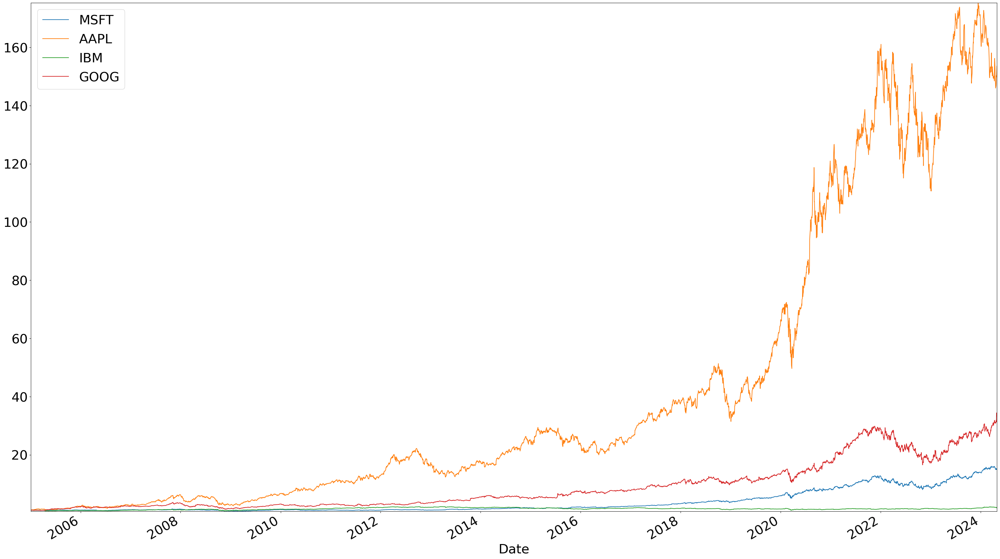

In [16]:
fig, ax = plt.subplots(figsize=(40,24))
close_data_normalized.plot.line(ax = ax)
plt.show()
plt.close()

### Daily Rate of Return

Derive the daily rate of return from the present value equation.

>$PV = \frac{FV}{(1 + r)^t}$
>
>Overall rate of return: $R=\frac{FV}{PV}$

Discount the overall rate of return to find the average rate of return. We will use this to define the mean of the standard normal distribution:

>$ r = (R)^{\frac{1}{t}} - 1$
>
>$t$ is measured in days

In [17]:
mean_var_df = pd.DataFrame(
    {"mean": close_data_normalized.iloc[-1].div(close_data_normalized.iloc[0]) ** (
        1 / close_data_normalized["MSFT"].count()) - 1, 
                            "sigma" : close_data_pct_change.std()})
mean_var_df

,mean,sigma
MSFT,0.000558,0.017236
AAPL,0.001036,0.020424
IBM,0.000120,0.014479
GOOG,0.000721,0.019003


In [18]:
num_sims = 500
dates = list(close_data_df.index)
monte_carlo_sim_dict = {}
for stock in stocks:
    monte_carlo_sim_dict[stock] = {}
    mean = mean_var_df["mean"][stock]
    sigma = mean_var_df["sigma"][stock]   
    run_monte_carlo(mean, 
                    sigma, 
                    num_sims, 
                    monte_carlo_sim_dict[stock], 
                    dates)
#    monte_carlo_sim_dict[stock] = pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod()
monte_carlo_sim_dfs = {stock: pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod() for stock in stocks}

In [19]:
monte_carlo_sim_dfs

{'MSFT':                   0         1         2         3          4          5    \
 2005-01-03   1.017663  0.981033  1.013090  0.992505   1.009906   1.000813   
 2005-01-04   1.016825  0.966343  1.018716  0.989022   0.972839   1.000837   
 2005-01-05   1.026021  0.983063  1.020821  0.994825   0.965124   0.986842   
 2005-01-06   1.007863  0.993720  1.001484  0.990425   0.940824   0.972270   
 2005-01-07   1.039197  0.993644  0.992190  0.969768   0.940581   0.930912   
 ...               ...       ...       ...       ...        ...        ...   
 2024-04-23  11.347708  1.774160  6.426353  2.746967  13.058653  14.126659   
 2024-04-24  11.442392  1.762978  6.344516  2.623676  13.247082  14.630661   
 2024-04-25  11.272582  1.749484  6.240082  2.650572  12.841181  14.914821   
 2024-04-26  11.216894  1.715525  6.228811  2.688751  12.658286  15.054504   
 2024-04-29  11.148315  1.697856  6.152557  2.659333  12.696338  15.185315   
 
                  6         7         8         9    .

In [20]:
def plot_monte_carlo_sim(sim_data, 
                         observed_data = None, 
                         title = None, 
                         logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)    
    index = sim_data.index
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop(["mean"], inplace = False, axis = 1).plot.line(
            legend=False, marker =".",
        markersize = .1, 
        color = "k", 
        alpha = .05, 
        logy = logy, 
        ax = ax)
    if observed_data is not None:
        observed_data.plot.line(legend = False, 
                                color = "C2", 
                                linewidth = 5, 
                                logy = logy, 
                                ax = ax)
    
        # find x coordinate of lowest value observed
        obs_text_x = observed_data[observed_data == observed_data.min()].index
        plt.text(obs_text_x, observed_data.loc[obs_text_x] * .7,
                 "Observed", fontsize = 70, color = "C2")
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    plt.text(index[-400], sim_data["mean"].iloc[-400] * 1.5, "Exp\nVal",
            fontsize = 70, color = "C3")
   
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

In [21]:
monte_carlo_sim_dfs[stock].median(axis = 1)

2005-01-03     0.999350
2005-01-04     1.003642
2005-01-05     1.003606
2005-01-06     1.004526
2005-01-07     1.003182
                ...    
2024-04-23    13.219726
2024-04-24    13.297609
2024-04-25    13.223355
2024-04-26    13.235574
2024-04-29    13.181011
Length: 4863, dtype: float64

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

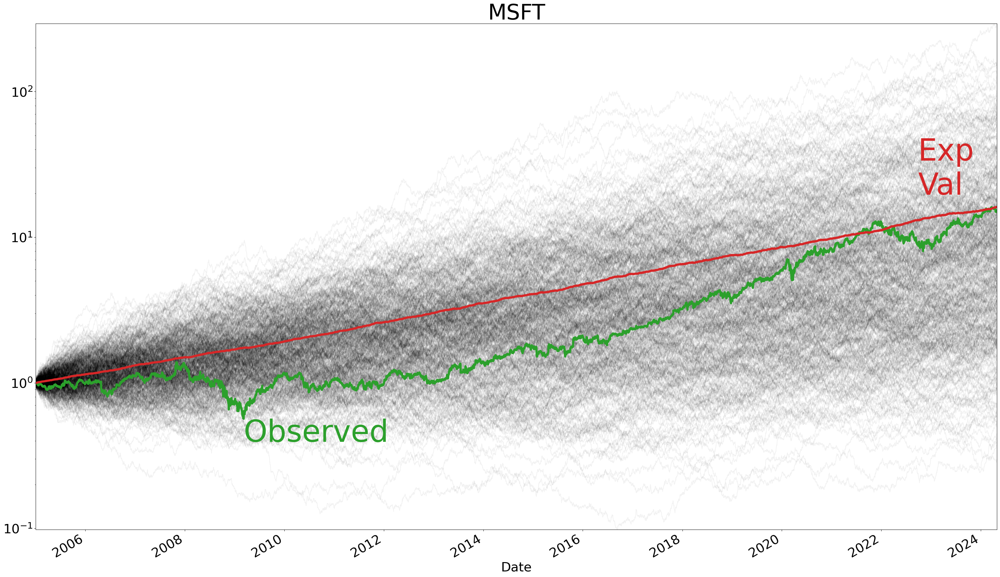

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

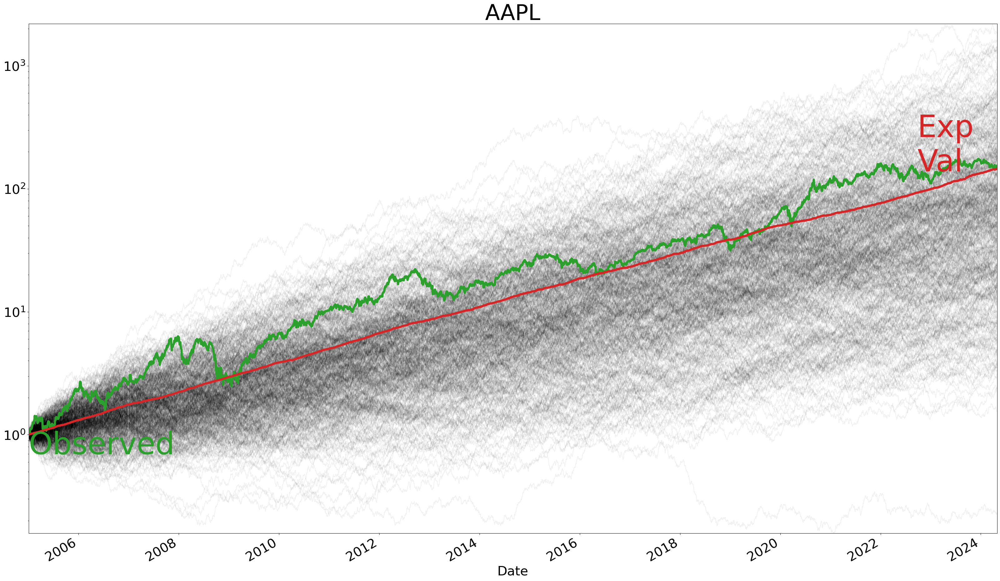

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

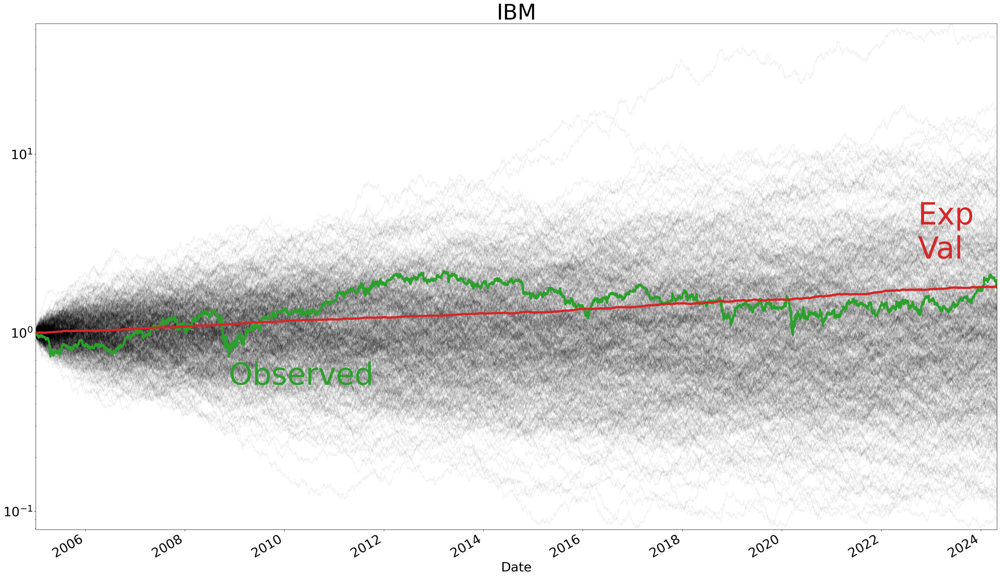

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

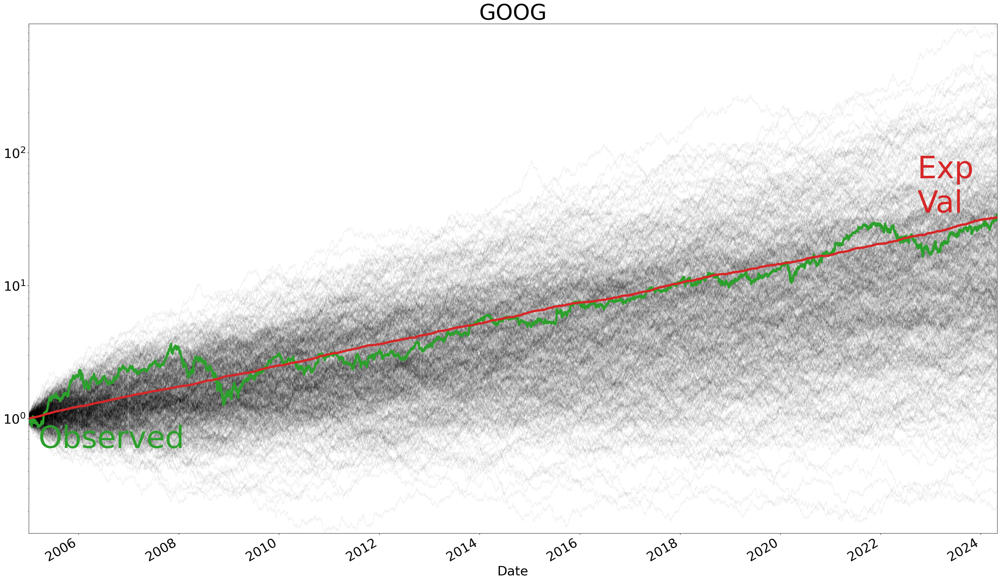

In [22]:
for stock in stocks:
    plot_monte_carlo_sim(monte_carlo_sim_dfs[stock], 
                         close_data_normalized[stock], 
                         stock, 
                         logy= True)


## Calculate Portfolio Return

In [23]:
portfolio_weights = {stock: 1 / len(stocks) for stock in stocks}
portfolio_weights

{'MSFT': 0.25, 'AAPL': 0.25, 'IBM': 0.25, 'GOOG': 0.25}

In [24]:
ex_return = pd.DataFrame(close_data_normalized.apply(lambda x :x.mul(portfolio_weights[x.name]),
                                                     axis = 0).sum(axis=1),
                                                    columns = ["Portfolio Return"])
close_data_normalized["Portfolio Return"] = ex_return
close_data_normalized

,MSFT,AAPL,IBM,GOOG,Portfolio Return
Date,,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499,0.990692
2005-01-05,1.001496,1.019118,0.987212,0.954615,0.990610
2005-01-06,1.000374,1.019908,0.984143,0.930146,0.983643
2005-01-07,0.997382,1.094169,0.979847,0.956292,1.006923
...,...,...,...,...,...
2024-04-23,15.241960,147.675711,1.949573,31.674689,49.135483
2024-04-24,15.297681,149.551529,1.970011,31.908408,49.681907
2024-04-25,14.922962,150.321314,1.807467,31.284499,49.584060


<Axes: xlabel='Date'>

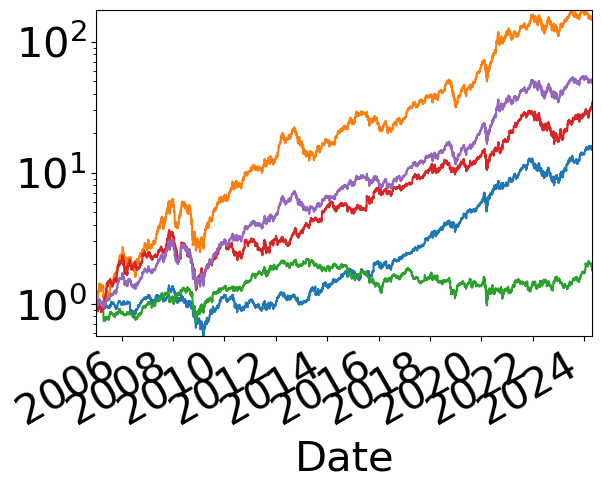

In [25]:
close_data_normalized.plot.line(legend=False, logy = True)

In [26]:
ex_return_pct_change = ex_return.pct_change()
ex_return_pct_change.dropna(inplace = True)
ex_return_pct_change

,Portfolio Return
Date,
2005-01-04,-0.009308
2005-01-05,-0.000082
2005-01-06,-0.007033
2005-01-07,0.023667
2005-01-10,0.001298
...,...
2024-04-23,0.008096
2024-04-24,0.011121
2024-04-25,-0.001969


In [27]:
mean_var_df = pd.DataFrame({"mean": (
    ex_return.iloc[-1] / ex_return.iloc[0]) **(
        1 / ex_return["Portfolio Return"].count()) -1,
                           "sigma" : ex_return_pct_change.std()})
mean_var_df

,mean,sigma
Portfolio Return,0.000808,0.016552


In [28]:
num_sims = 1000
dates = ex_return.index
monte_carlo_sim_dict = {}
mean = mean_var_df["mean"]["Portfolio Return"]
sigma = mean_var_df["sigma"]["Portfolio Return"]
run_monte_carlo(mean, 
                sigma, 
                num_sims, 
                monte_carlo_sim_dict, 
                dates)
monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).add(1).cumprod()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2005-01-03,1.011615,0.988048,1.009479,1.017729,1.019957,1.011802,0.971073,0.996372,1.018020,0.987482,...,1.000265,0.998194,1.027304,0.998485,1.033836,0.981066,0.984819,1.002048,0.988765,1.000572
2005-01-04,1.012092,0.973295,1.003161,0.993037,1.028829,1.005992,0.973229,1.005803,1.039129,0.954805,...,1.030567,0.995150,1.014396,0.977901,1.028644,0.967328,0.989947,1.001711,0.956466,0.980662
2005-01-05,1.021860,0.976129,1.022515,0.991597,1.032412,1.012991,0.968592,1.004443,1.051687,0.982624,...,1.036755,1.001742,0.975444,0.959929,1.064383,0.964952,0.975876,0.987136,0.937261,0.977495
2005-01-06,1.003398,0.962680,1.050396,0.983896,1.029352,1.014786,0.991440,1.014950,1.085774,0.986142,...,1.040914,1.014429,0.967824,0.979827,1.099943,0.924284,0.977145,0.977249,0.943226,0.996679
2005-01-07,1.011640,0.959610,1.055065,0.998533,1.031386,1.026020,0.986588,1.031285,1.092568,0.972543,...,1.037198,1.003538,0.997127,0.972086,1.069528,0.947595,0.991101,0.976505,0.929422,0.984809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-23,176.880662,36.454507,10.541297,96.615069,71.973651,23.796795,63.637578,5.397184,3.573375,66.041499,...,68.028210,12.720913,42.555401,41.212908,29.091510,15.290894,28.405854,8.380587,30.788630,118.100476
2024-04-24,178.489674,37.690028,10.619463,95.067401,72.837785,24.053311,64.988620,5.546991,3.596935,64.324007,...,69.499386,12.766508,42.886702,41.250581,28.367613,15.253578,28.799658,8.345115,30.128456,121.130441
2024-04-25,179.725344,37.372629,10.855084,94.387203,74.628757,23.390363,65.547302,5.451569,3.670993,63.813921,...,69.099954,12.753474,43.449249,41.515891,26.883281,15.025676,28.878496,8.206368,30.441801,121.496558
2024-04-26,179.188805,37.168225,10.830522,92.916502,74.499362,23.019100,66.379441,5.508930,3.674236,65.620693,...,67.996182,12.760632,42.771636,41.301348,26.906383,14.859920,28.743857,8.237997,30.278972,121.548356


C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

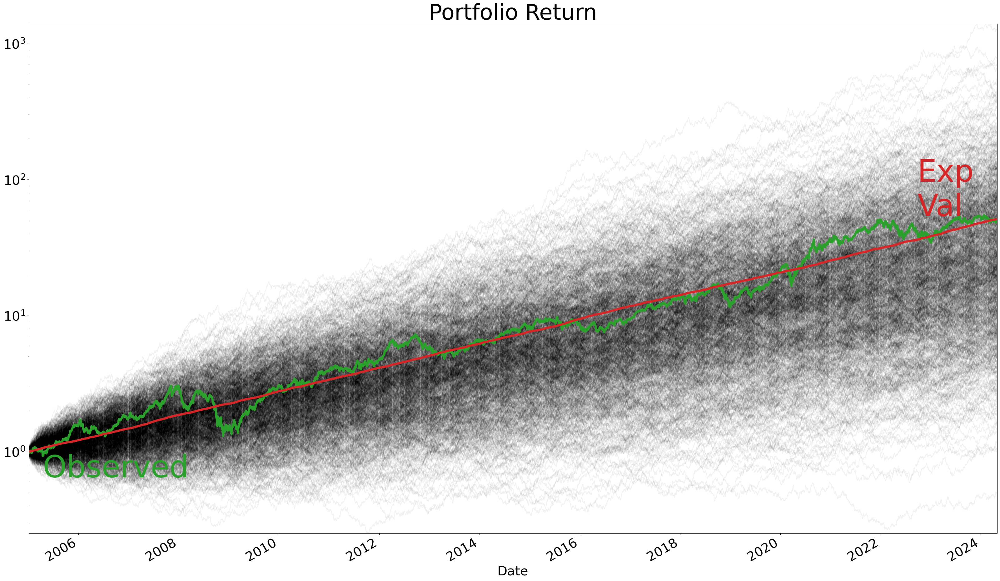

In [29]:
plot_monte_carlo_sim(monte_carlo_sim_df, 
                     ex_return["Portfolio Return"], 
                     "Portfolio Return", 
                     logy= True)